In [7]:
import networkx as nx 
import numpy as np
from scipy.sparse.linalg import expm_multiply
from scipy.stats import expon
import matplotlib.pyplot as plt
import imageio
import os
from pathlib import Path
import time

from IPython.core.interactiveshell import InteractiveShell
from IPython import display

InteractiveShell.ast_node_interactivity = "all"

In [2]:
def build_gif(gif_filename, img_filenames, frames_per_img=1):
  with imageio.get_writer(gif_filename, mode='I') as writer:
      for filename in img_filenames:
          image = imageio.imread(filename)
          for i in range(frames_per_img):
              writer.append_data(image)

[How to do a GIF](https://towardsdatascience.com/basics-of-gifs-with-pythons-matplotlib-54dd544b6f30)

# Functions for quantum walk simulation

Function to calculate the i-th canonical vector in $C^n$

In [3]:
def canonical_vector(i, n):
  # i-esimo vector canonico en C^n
  ei = np.zeros(n)
  ei[i] = 1.0
  return ei

Function to simulate a measurement of the quantum walk

In [4]:
def measurement_basis(state, basis):
  # state is a vector in C^N

  qprobs = abs(state)**2
  collapse = np.random.choice(basis, p=qprobs)

  return collapse

Text(0.5, 1.0, 'Example')

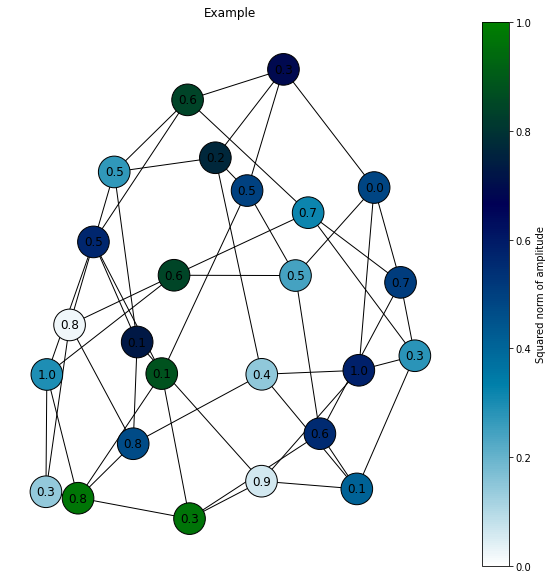

In [6]:
G= nx.random_regular_graph(4, 25, seed=0) #nx.binomial_graph(10, 0.5) #nx.star_graph(19)
pos=nx.spring_layout(G)
colors=np.random.uniform(size=G.number_of_nodes())

fig, ax = plt.subplots(figsize=(10,10))
cmap=plt.cm.ocean_r
nx.draw(G, pos, labels={d : f"{colors[d]:.1f}" for d in G}, node_color=colors, cmap=cmap, vmin=0, vmax=1,
           with_labels=True, edgecolors="black", node_size=1000, ax=ax)

norm = plt.Normalize(0, 1)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm._A = []
plt.colorbar(sm, ax=ax, label="Squared norm of amplitude")
ax.set_title("Example")
fig.show()

# Quantum walk simulation

In [14]:
def save_quantum_walk_state(graph, pos, state, filename, title):
  fig, ax = plt.subplots(figsize=(10,10))
  colors=(abs(state)**2).tolist()
  cmap=plt.cm.ocean_r
  nx.draw(graph, pos, node_color=colors, vmin=0, vmax=1, cmap=cmap, with_labels=False, edgecolors="black", ax=ax, node_size=1000)
  norm = plt.Normalize(0, 1)
  sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
  sm._A = []
  plt.colorbar(sm, ax=ax, label="Squared norm of amplitude")
  ax.set_title("A Quantum Walk - "+title)
  fig.savefig(filename, bbox_inches='tight')

  plt.close(fig)

In [28]:
def continuousQuantumWalk(graph, initial_state, gamma, measurement_rate, states_between_measurements, num_measurements):
  M = graph.order()
  pos=nx.spring_layout(graph, seed=0) # layout of graph

  H = -gamma*nx.laplacian_matrix(graph).toarray() # Hamiltonian

  no_measurement = 0
 
  actual_state = initial_state 
  actual_state_vec = canonical_vector(actual_state, M) # vector representing genotype actual_state

  # Start of simulation
  while no_measurement < num_measurements:
    T = expon.rvs(scale=1/measurement_rate, size=1)[0] # time between measurements
    
    # evolving quantum walk
    evolution = expm_multiply(-1j*H, actual_state_vec, start=0, stop=T, num=states_between_measurements, endpoint=True) # evolve quantum walk until time T with actual_state as initial state

    for i, state in enumerate(evolution):
      save_quantum_walk_state(graph, pos, state, f"quantumwalks/measurement:{no_measurement}-state{i}", f"{no_measurement}/{num_measurements} measurements, state {i+1}/{states_between_measurements}")

    measurement_result = measurement_basis(evolution[-1], graph.nodes)
    print("Measurement result:", measurement_result)
    actual_state_vec = canonical_vector(measurement_result, M)

    no_measurement += 1

    actual_state = measurement_result

  save_quantum_walk_state(graph, pos, state, f"quantumwalks/measurement:{no_measurement}-state{0}", f"{no_measurement}/{num_measurements} measurements, state 1/1")
      
  # End of simulation

In [54]:
initial_state = 0
graph = nx.random_regular_graph(4, 25, seed=0) #nx.binomial_tree(5)
graph = nx.convert_node_labels_to_integers(graph)
gamma = 20
measurement_rate = 10
states_between_measurements = 5
num_measurements = 7

if not os.path.exists("quantumwalks"):
    os.makedirs("quantumwalks")

start = time.time()
continuousQuantumWalk(graph, initial_state, gamma, measurement_rate, states_between_measurements, num_measurements)
print("Execution time:", time.time()-start, "s")

Measurement result: 16
Measurement result: 14
Measurement result: 5
Measurement result: 1
Measurement result: 17
Measurement result: 17
Measurement result: 15
Execution time: 10.36039423942566 s


In [55]:
# Build GIF
start = time.time()
build_gif(
    "quantumwalk.gif", 
    [f"quantumwalks/measurement:{i}-state{j}.png" for i in range(num_measurements) for j in range(states_between_measurements)]
    +[f"quantumwalks/measurement:{num_measurements}-state{0}.png"],
    frames_per_img=7
    )
print("Execution time:", time.time()-start, "s")

Execution time: 9.440125703811646 s


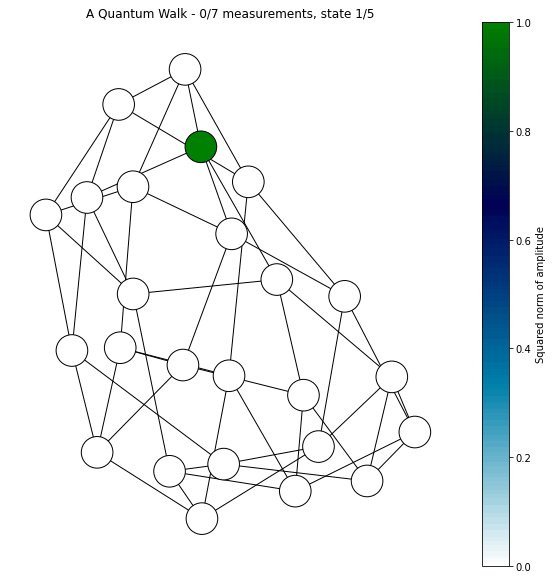

In [56]:
gifPath = Path("quantumwalk.gif") # please paste the whole path from Step 2-6
# Display GIF in Jupyter, CoLab, IPython
with open(gifPath,'rb') as f:
    display.Image(data=f.read(), format='png')

# Funtions for random walk simulation

In [32]:
def nextState(states, i, Q):
  # choose next state to jump to from the i-th row of the jump process transition matrix
  # states are the set of state of the random walk
  # i is the actual state
  # Q is the infinitesimal generator of the continuous random walk
  probs = [-Q[i, j]/Q[i, i] for j in states]
  probs[i] = 0 

  return np.random.choice(states, p = probs)

In [36]:
def save_random_walk_state(graph, pos, state, filename, title):
  fig, ax = plt.subplots(figsize=(10,10))

  colors = ["green" if v == state else "white" for v in graph] # colors of nodes

  nx.draw(graph, pos, node_color=colors, with_labels=False, edgecolors="black", ax=ax, node_size=1000)
  ax.set_title("A Random Walk - "+title)
  fig.savefig(filename, bbox_inches='tight')

  plt.close(fig)

# Random walk simulation

In [34]:
def continuousRandomWalk(graph, initial_state, gamma, num_jumps):
  pos=nx.spring_layout(graph, seed=0) # layout of graph

  jump = 0

  H = -gamma*nx.laplacian_matrix(graph) # infinitesimal generator

  actual_state = initial_state
  save_random_walk_state(graph, pos, actual_state, f"randomwalks/jump{jump}.png", f"Jump {jump}/{num_jumps}")

  # start of simulation
  while jump < num_jumps:
    T = expon.rvs(scale = -1/H[actual_state, actual_state], size=1)[0] # holding time
    jump += 1
    
    # choice next random state
    actual_state = nextState(graph.nodes, actual_state, H)
    save_random_walk_state(graph, pos, actual_state, f"randomwalks/jump{jump}.png", f"Jump {jump}/{num_jumps}")
  
  # end of simulation

In [37]:
initial_state = 0
graph = nx.random_regular_graph(4, 25, seed=0)
graph = nx.convert_node_labels_to_integers(graph)
gamma = 20
num_jumps = 8

if not os.path.exists("randomwalks"):
    os.makedirs("randomwalks")

start = time.time()
continuousRandomWalk(graph, initial_state, gamma, num_jumps)
print("Execution time:", time.time()-start, "s")

Execution time: 2.014514207839966 s


In [38]:
# Build GIF
start = time.time()
build_gif(
    "randomwalk.gif", 
    [f"randomwalks/jump{j}.png" for j in range(num_jumps+1)],
    frames_per_img=10
    )
print("Execution time:", time.time()-start, "s")

Execution time: 4.313411712646484 s


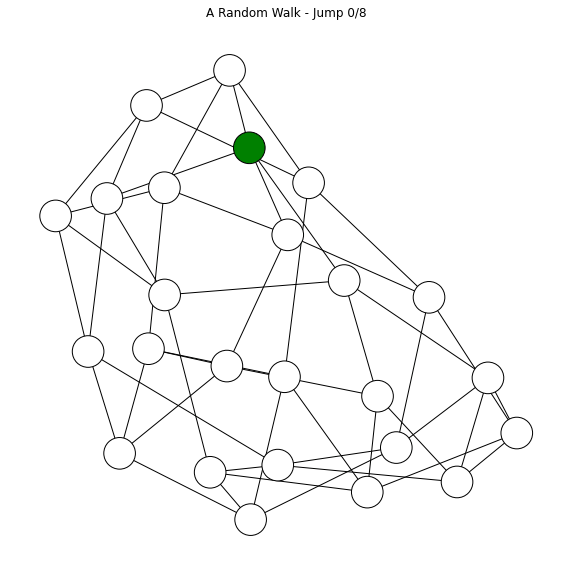

In [39]:
gifPath = Path("randomwalk.gif") # please paste the whole path from Step 2-6
# Display GIF in Jupyter, CoLab, IPython
with open(gifPath,'rb') as f:
    display.Image(data=f.read(), format='png')